# PyCap runs for Wisconsin DNR

This notebook assumes that you have already created a excel file with all the starting information. This script will convert that `.xlsx` file into a `.yml`. Then PyCap can be run in deterministic mode (single run with base parameters), or Monte Carlo mode. 


### Provide file names, choose options

##### `Draft = N` puts the script into "Final Run" mode, which will add the well locations and impact locations to a database on the server. Run this version only once after you are happy with all the runs. 
##### `Draft = Y` keeps the script in "Draft" mode. The outputs to the PyCap run will still be saved locally for you to explore.

#####

##### The `MonteCarlo` option puts the model in Deterministic (`N`) or Monte Carlo (`Y`) mode.


In [19]:
#### Path to excel input file. Note can use absolute or relative path.
pycap_inputs_excel = r"Inputs/LPR_Prepped.xlsx"

#### PyCap Run Name is what all your outputs will have as a name. 
pycap_run_name = "LPR_Redux"

Draft = "Y"
MonteCarlo = "Y"

Reviewer_Name = "Pruitt"


##### Libraries you will need to run this script

In [20]:
import yaml
import pandas as pd
import numpy as np
from pathlib import Path
import sys

import shutil
sys.path.append('../dependencies/')
import pyemu
import matplotlib.pyplot as plt
import pathlib as pl
import os, platform

import geopandas as gpd
from shapely.geometry import Point
from  datetime import date


### Create YML from Excel
##### Created with a function

In [21]:
def Excel2YML(pycap_inputs_excel):
    # read in the raw files from excel
    raw_global = pd.read_excel(pycap_inputs_excel, sheet_name = 'Global_Inputs')
    raw_hcw = pd.read_excel(pycap_inputs_excel, sheet_name = 'HCW_Inputs')
    raw_dd = pd.read_excel(pycap_inputs_excel, sheet_name = 'Drawdown_Inputs')
    raw_depl = pd.read_excel(pycap_inputs_excel, sheet_name = 'Depletion_Inputs')

    # munging to make everything readable by python
    raw_hcw["HCW"] = raw_hcw["HCW"].astype(str)
    raw_dd["HCW"] = raw_dd["HCW"].astype(str)
    raw_depl["HCW"] = raw_depl["HCW"].astype(str)
    raw_dd["pycap_resource_name"] = raw_dd["Resource_Name"]
    raw_depl["pycap_resource_name"] = raw_depl["Resource_Name"]

    raw_dd["Resource_Name"] = [i.replace(" ", "") for i in raw_dd["Resource_Name"]]
    raw_dd["pycap_resource_name"] = [
        ":".join((rn, hcw)) for rn, hcw in zip(raw_dd["Resource_Name"], raw_dd["HCW"])
    ]

    raw_depl["Resource_Name"] = [i.replace(" ", "") for i in raw_depl["Resource_Name"]]
    raw_depl["pycap_resource_name"] = [
        ":".join((rn, hcw)) for rn, hcw in zip(raw_depl["Resource_Name"], raw_depl["HCW"])
    ]    

    # create a global project properties dictionary
    global project_dict
    project_dict = dict()
    project_dict['project_properties'] = {
        'name':pycap_run_name,
        'T':float(raw_global['Transmissivity_ft2d'][0]),
        'Max_T':float(raw_global['Max_Trans_ft2d'][0]),
        'Min_T':float(raw_global['Min_Trans_ft2d'][0]),
        'S':float(raw_global['Storage_Coeff'][0]),
        'Max_S':float(raw_global['Max_S'][0]),
        'Min_S':float(raw_global['Min_S'][0]),
        'Max_FracInt':float(raw_global['Max_FractInt'][0]),
        'Min_FracInt':float(raw_global['Min_FractInt'][0]),
        'default_dd_days':float(raw_global['Default_dd_days'][0]),
        'default_depletion_years':float(raw_global['Default_depletion_years'].values[0]),
        'default_pumping_days':float(raw_global['Default_pumping_days'].values[0])
    }    

    global stream_dict 
    stream_dict = dict()
    stream_dict = {
        i: {
            "HCW": hcw,
            "stream_apportionment": {
                "name": pycap_resource_name,
                "apportionment": float(frac_intercept),
            },
        }
        for i, hcw, pycap_resource_name, frac_intercept in zip(
            range(len(raw_depl)),
            raw_depl["HCW"],
            raw_depl["pycap_resource_name"],
            raw_depl["Fraction_Intercept"],
        )
    }

    global well_dict
    welll_dict = dict()
    well_dict = {
        i: {
            "name": hcw,
            "status": well_stat.lower(),
            "loc": {
                "x": float(well_long),
                "y": float(well_lat),
            },
            "Q": float(Q_gpm),
            "pumping_days": int(pump_days),
        }
        for i, hcw, well_stat, well_long, well_lat, Q_gpm, pump_days in zip(
            range(len(raw_hcw)),
            raw_hcw["HCW"],
            raw_hcw["Well_Status"],
            raw_hcw["Well_Long"],
            raw_hcw["Well_Lat"],
            raw_hcw["Q_gpm"],
            raw_hcw["Pumping_Days"],
        )
    }

    stream_dict_df = pd.DataFrame.from_dict(stream_dict, orient="index")
    stream_dict_df = stream_dict_df.rename("stream_apportionment{}".format)

    well_dict = {i["name"]: i for _, i in well_dict.items()}

    if len(raw_depl["HCW"]) > 0:
    # bring in the stream apportionment values
        for j in well_dict:
            well_dict[j].update(
                stream_dict_df.loc[stream_dict_df["HCW"] == j]["stream_apportionment"]
            )

    # bring in the stream and drawdown response information
    for j in well_dict:
        well_dict[j].update(
            {
                "stream_response": (
                    list(raw_depl.loc[raw_depl["HCW"] == j]["pycap_resource_name"])
                )
            }
        )
        well_dict[j].update(
            {"dd_response": (list(raw_dd.loc[raw_dd["HCW"] == j]["Resource_Name"]))}
        )

    # rename the keys again
    well_dict = {f"well_{k}": v for k, v in well_dict.items()}

    streamresp_dict = {
        f"stream_response{i}": {
            "name": pycap_resource_name,
            "loc": {
                "x": float(res_long),
                "y": float(res_lat),
            },
        }
        for i, pycap_resource_name, res_long, res_lat in zip(
            range(len(raw_depl)),
            raw_depl["pycap_resource_name"],
            raw_depl["Resource_Long"],
            raw_depl["Resource_Lat"],
        )
    }

    raw_dd_unique = raw_dd.drop_duplicates(subset=["Resource_Name"]).reset_index()

    global ddresp_dict
    ddresp_dict = dict()
    ddresp_dict = {
        f"dd_response{i}": {
            "name": ResName,
            "loc": {
                "x": float(res_long),
                "y": float(res_lat),
            },
        }
        for i, ResName, res_long, res_lat in zip(
            range(len(raw_dd_unique)),
            raw_dd_unique["Resource_Name"],
            raw_dd_unique["Resource_Long"],
            raw_dd_unique["Resource_Lat"],
        )
    }

    combdict = {**project_dict, **well_dict, **ddresp_dict, **streamresp_dict}
    yml_name = pycap_run_name + ".yml"

    with open(yml_name, "w") as file:
        documents = yaml.dump(combdict, file, default_flow_style=False, sort_keys=False)

     

In [22]:
Excel2YML(pycap_inputs_excel)

In [23]:
well_dict

{'well_418': {'name': '418',
  'status': 'pending',
  'loc': {'x': 89.4839267, 'y': 44.4430733},
  'Q': 109.5,
  'pumping_days': 90,
  'stream_apportionment0': {'name': 'LPR:418', 'apportionment': 0.6612},
  'stream_response': ['LPR:418'],
  'dd_response': ['LakeEmily']},
 'well_466': {'name': '466',
  'status': 'existing',
  'loc': {'x': 89.4939505, 'y': 44.4611747},
  'Q': 315.9,
  'pumping_days': 330,
  'stream_apportionment1': {'name': 'LPR:466', 'apportionment': 0.9763},
  'stream_response': ['LPR:466'],
  'dd_response': []},
 'well_467': {'name': '467',
  'status': 'existing',
  'loc': {'x': 89.4939729, 'y': 44.458573},
  'Q': 296.9,
  'pumping_days': 330,
  'stream_apportionment2': {'name': 'LPR:467', 'apportionment': 0.9548},
  'stream_response': ['LPR:467'],
  'dd_response': []},
 'well_490': {'name': '490',
  'status': 'existing',
  'loc': {'x': 89.3121079, 'y': 44.4666573},
  'Q': 27.7,
  'pumping_days': 330,
  'stream_apportionment3': {'name': 'LPR:490', 'apportionment': 0.

### Run `pycap` with existing YML file


In [24]:

# add relative path to the pycap-dss to sys.path
sys.path.insert(1, "../")
from pycap.analysis_project import Project

##### Path to the folder and name of the .yml created above

In [25]:
datapath = Path("")
yml_name = pycap_run_name + ".yml"
yml_file = yml_name


#### Call `pycap.analysis_project` to run Python tool

In [26]:
ap = Project(datapath / yml_file)
ap.report_responses()
ap.write_responses_csv()

Writing report to LPR_Redux.yml.import_report



Successfully parsed LPR_Redux.yml (high five!)
*************************
Summary follows:

WELLS:
326 existing wells:
	466
	467
	490
	509
	602
	603
	798
	807
	850
	862
	1013
	1302
	1323
	1486
	1584
	1589
	1643
	1683
	1860
	2544
	2750
	2886
	3473
	3949
	4171
	23610
	23611
	23618
	23620
	23627
	23629
	23630
	23631
	23635
	23637
	23638
	23639
	23645
	23646
	23648
	23653
	23695
	23697
	23698
	23699
	23700
	23709
	23710
	23715
	23716
	23720
	23721
	23722
	23723
	23726
	23727
	23728
	23729
	23751
	23752
	23753
	23754
	23755
	23756
	23757
	23758
	23770
	23776
	23778
	23781
	23790
	23791
	23794
	23795
	23798
	23800
	23807
	23816
	23818
	23820
	23823
	23836
	23837
	23846
	23847
	23848
	23851
	23864
	23865
	23866
	23867
	23868
	23869
	23870
	23876
	23881
	23883
	23886
	23888
	23889
	23890
	23895
	23898
	23908
	23909
	23910
	23913
	23915
	23919
	23926
	23928
	23929
	23930
	23934
	23936
	23937
	23939
	23942
	23944
	23948
	23956
	23961
	23962
	23963


#### Now let's have a look at the main results files
##### First the summary base depletion

In [27]:
depl = pd.read_csv(
    'output/{}.table_report.base_stream_depletion.csv'.format(pycap_run_name), index_col = 0
)
depl

,LPR
418,8.696664e-03
466,4.548644e-01
467,3.569738e-01
490,7.699735e-13
509,2.303785e-07
...,...
94988,1.201666e-08
95068,5.519772e-06
total_proposed,8.696664e-03
total_existing,5.501314e+00


##### Combined report of all depletion and drawdown calculations

In [28]:
tab_report = pd.read_csv (
    "output/{}.table_report.csv".format(pycap_run_name), index_col=0
)
tab_report

,LakeEmily:dd (ft),LPR:466:depl (cfs),LPR:467:depl (cfs),LPR:490:depl (cfs),LPR:509:depl (cfs),LPR:602:depl (cfs),LPR:603:depl (cfs),LPR:798:depl (cfs),LPR:807:depl (cfs),LPR:850:depl (cfs),...,LPR:93349:depl (cfs),LPR:93422:depl (cfs),LPR:93423:depl (cfs),LPR:93424:depl (cfs),LPR:93469:depl (cfs),LPR:93832:depl (cfs),LPR:94302:depl (cfs),LPR:94988:depl (cfs),LPR:95068:depl (cfs),LPR:418:depl (cfs)
418: proposed,6.294692e-138,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.008697
466: existing,NaN,0.454864,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
467: existing,NaN,NaN,0.356974,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
490: existing,NaN,NaN,NaN,7.699735e-13,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
509: existing,NaN,NaN,NaN,NaN,2.303785e-07,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94988: existing,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.201666e-08,NaN,NaN
95068: existing,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000006,NaN
total_proposed,6.294692e-138,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.008697
total_existing,NaN,0.454864,0.356974,7.699735e-13,2.303785e-07,6.541480e-16,3.621943e-16,3.692045e-08,0.000205,0.000002,...,0.000038,9.300970e-16,9.836970e-16,2.333270e-15,0.00888,6.317281e-15,0.044645,1.201666e-08,0.000006,NaN


##### All the depletion time series 

Text(0, 0.5, 'Depletion, cfs')

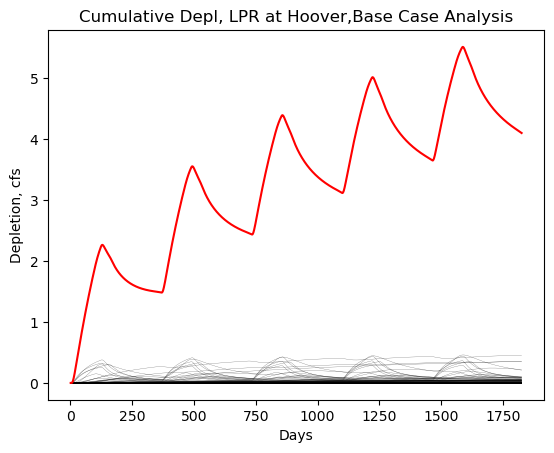

In [47]:
all_time_series = pd.read_csv(
    "output/{}.table_report.all_ts.csv".format(pycap_run_name), index_col=0
)

cum_depl = all_time_series.sum(axis=1)

fig,ax = plt.subplots(nrows=1, ncols=1)
ax.plot(all_time_series, alpha=0.6, c='k', lw=0.2)
ax.plot(cum_depl, c='r')
ax.set_title('Cumulative Depl, LPR at Hoover,Base Case Analysis')
ax.set_xlabel("Days")
ax.set_ylabel('Depletion, cfs')


# Monte Carlo Analysis

### Only runs if `MonteCarlo = "Y"`. Assumes the max/min parameters are set in the excel notebook. 

####

#### Currently only setup to vary T, S, and FI. 
#### Note: The fraction intercept variations are 'dumb', in that they are not force to add up to 1.

In [48]:
def SetupMC():
    # setup directories needed
    wkdir = pl.Path('.')
    global template_dir
    template_dir = pl.Path('./tmpdir')
    sen_template_dir = pl.Path('./tmpdir_sen')
    if template_dir.exists():
        shutil.rmtree(template_dir)
    template_dir.mkdir()
    if sen_template_dir.exists():
        shutil.rmtree(sen_template_dir)

    input_yml = pycap_run_name
    input_yml_asyml = yml_name

    with open(wkdir / input_yml_asyml, 'r') as ifp:
        indat = yaml.safe_load(ifp)

    
    # Setup parameterizations
    T_init = indat['project_properties']['T']
    S_init = indat['project_properties']['S']

    indat['project_properties']['T'] = f'~{"global_T":^16s}~'
    indat['project_properties']['S'] = f'~{"global_S":^16s}~'

    # get initial apportionments
    well_keys = [i for i in indat.keys() if i.startswith('well_')]
    app_keys = [[j for j in indat[i].keys() if j.startswith('stream_apportionment')]
                for i in well_keys]
    pending_wells = [i for i in well_keys if 'pending' in indat[i]['status']]
    allkeys = dict(zip(well_keys, app_keys))

    pars = list()
    parvals = list()

    for k,v in allkeys.items():
        for cv in v:
            cpar = f'{k}__{cv}'
            pars.append(cpar)
            parvals.append(indat[k][cv]['apportionment'])
            indat[k][cv]['apportionment'] = f'~{cpar:^45}~'

    # create df of parameters
    pars_df = pd.DataFrame(index = pars, data= {'parval1':parvals})

    # add initial parameters to df
    pars_df = pd.concat([pars_df, pd.DataFrame(index = ['global_s','global_t'], data = {'parval1':[S_init,T_init]})])

    # save out tpl file
    with open(template_dir / f"{input_yml}.yml.tpl", 'w') as ofp:
        ofp.write('ptf ~\n')
        documents = yaml.dump(indat, ofp, default_flow_style = False, sort_keys = False)

    # make ins file and external forward run file
    # set base case depletion observations
    basedeplobs = [f"{indat[k]['name']}:bdpl" for k in indat.keys() if 'stream' in k]
    
    # get list of unique stream names used in the run
    unique_rivers = list(set([i.split(':')[0] for i in basedeplobs]))

    # add in the totals/sums of proposed/existing/combined depletions for each stream
    basedeplobs.extend([f'{i}:{j}:bdpl' for i in unique_rivers for j in ['total_proposed','total_existing','total_combined']])

    with open(template_dir / 'basedeplobs.dat','w') as ofp:
        [ofp.write(i + '\n') for i in basedeplobs]


    # add time-series
    # choose wells with individual time-series outputs. Below just has the pending wells
    #pending_well = [f"{i}:{j.replace('well_','')}" for i in unique_rivers for j in pending_wells]
    allstrmobs = [f"{indat[k]['name']}" for k in indat.keys() if "stream" in k]
    output_ts = allstrmobs 

    # times you want to look at individual outputs, in this case just the depletions in the 5th year
    times = range(365*4,365*5+1) 
    ts_obs = []
    for c_ts in output_ts:
        ts_obs.extend([f'{c_ts}__{i}' for i in times])
    allobs = basedeplobs + ts_obs

    with open(template_dir / 'ts_obs.dat' , 'w') as ofp:
        [ofp.write(c_ts + '\n') for c_ts in output_ts]

    # read in base case run
    odir = pl.Path('output')
    base_data = pd.read_csv(odir/f'{input_yml}.table_report.base_stream_depletion.csv', index_col=0)
    bdplobs = pd.read_csv(template_dir/'basedeplobs.dat', header=None)
    bdplobs.columns =['obsname']
    bdplobs.index = bdplobs.obsname
    bdplobs['obs_values'] = np.nan

    for cob in bdplobs.obsname:
        riv,wel,_ = cob.split(':')
        bdplobs.loc[cob, 'obs_values'] = base_data.loc[wel][riv]

    ts_data = pd.read_csv(odir/f'{input_yml}.table_report.all_ts.csv',index_col=0)
    ts_data.columns = ts_data.columns.str.split('__').str[-1]
    ts_path = template_dir / 'ts_obs.dat' 
    output_ts = [i.strip() for i in open(ts_path, 'r').readlines()]
    ts_df = pd.DataFrame(index= ts_obs,  data = {'obsname':ts_obs, 'obs_values':np.nan})
    for cob in ts_df.index:
        criv,ctime=cob.split('__')
        ts_df.loc[cob, 'obs_values'] = ts_data.loc[int(ctime)][criv]

    allout = pd.concat([bdplobs,ts_df])
    allout['obs_values'].to_csv(template_dir / 'allobs.out', sep = ' ', header=None)

    with open(template_dir / 'allobs.out.ins', 'w') as ofp:
        ofp.write('pif ~\n')
        [ofp.write(f'l1 w !{i}!\n') for i in allout.index]

    # make pst file
    global cwd
    cwd = os.getcwd()
    os.chdir(template_dir)
    pst = pyemu.Pst.from_io_files(*pyemu.utils.parse_dir_for_io_files('.'))
    os.chdir(cwd)

    pars = pst.parameter_data
    pars.loc[pars_df.index,'parval1'] = pars_df.parval1

    # set apportionment changes
    # how much to change apportionment
    del_apport = 0.1

    # apport lower and upper bound
    #pars.loc[pars.index.str.startswith('well_'),'parlbnd'] = pars.loc[pars.index.str.startswith('well_'),'parval1']-.1
    pars.loc[pars.index.str.startswith('well_'),'parlbnd'] = pars.loc[pars.index.str.startswith('well_'),'parval1']-del_apport
    pars.loc[pars.index.str.startswith('well_'),'parubnd'] = pars.loc[pars.index.str.startswith('well_'),'parval1']+del_apport

    #set parameter group ('pargrp') for apportionment
    pars.loc[pars.index.str.startswith('well_'),'pargp'] = 'apportionment'

    # force overall lowerbound and upperbound as defined in .xlsx inputs
    pars.loc[(pars.pargp=='apportionment')&(pars.parlbnd < project_dict['project_properties']['Min_FracInt']),'parlbnd'] = project_dict['project_properties']['Min_FracInt']
    pars.loc[(pars.pargp=='apportionment')&(pars.parubnd > project_dict['project_properties']['Max_FracInt']),'parubnd'] = project_dict['project_properties']['Max_FracInt']

    # add parameter groups for T and S
    pars.loc['global_t','pargp'] = 'global_t'
    pars.loc['global_s','pargp'] = 'global_s'

    # set lower and upper bounds for T and S as defined in .xlsx inputs
    pars.loc[(pars.pargp=='global_t'),'parlbnd'] = project_dict['project_properties']['Min_T']
    pars.loc[(pars.pargp=='global_t'),'parubnd'] = project_dict['project_properties']['Max_T']

    pars.loc[(pars.pargp=='global_s'),'parlbnd'] = project_dict['project_properties']['Min_S']
    pars.loc[(pars.pargp=='global_s'),'parubnd'] = project_dict['project_properties']['Max_S']

    # set transforms for all parameters to 'none', except for T which can be a log-transform

    pars.partrans = 'none'
    pars.loc['global_t','partrans']='log'

    # setup and save pst file
    pst.control_data.noptmax = -1
    pst.model_command = [f'python run_pycap.py {yml_name} ts_obs.dat']
    pst.pestpp_options['par_sigma_range']=6
    pst.pestpp_options['ies_num_reals'] = 500

    pst.write(str(template_dir / 'prior_mc.pst'), version=2)

    # Copy over dir

    current_dir = os.getcwd()
    PyCap_Path = os.path.join(current_dir, '..','pycap')

    shutil.copy2('run_pycap.py',template_dir/'run_pycap.py')
    shutil.copy2(yml_name, template_dir)

    if (template_dir/'pycap-dss').exists():
        shutil.rmtree(template_dir/'pycap-dss'/'pycap')

    shutil.copytree(PyCap_Path, template_dir/'pycap-dss'/'pycap')

    if (template_dir/'output').exists():
        shutil.rmtree(template_dir/'output')
    
    shutil.copytree(os.path.join(current_dir, 'output'), template_dir/'output')

In [49]:
current_dir = os.getcwd()
PyCap_Path = os.path.join(current_dir, '..','..','..','pycap-dss','pycap-dss','pycap')
PyCap_Path

'C:\\Users\\pruita\\Documents\\LPR_redux\\PyCap\\PyCap_USGS\\pycap-dss\\Notebooks\\..\\..\\..\\pycap-dss\\pycap-dss\\pycap'

In [50]:
os.getcwd()

'C:\\Users\\pruita\\Documents\\LPR_redux\\PyCap\\PyCap_USGS\\pycap-dss\\Notebooks'

In [51]:
# run MC
run_global_sen = False
run_global_sen_distrib = False
run_ies = True


if MonteCarlo == "Y":
    SetupMC()

    os.chdir(cwd)
    if run_ies:
        if 'window' in platform.platform().lower():
            pestpp_ex = '../../dependencies/win_bin/pestpp-ies'
        else:
            pestpp_ex = '../../dependencies/mac_bin/pestpp-ies'
        pyemu.os_utils.start_workers(
                worker_dir=str(template_dir), 
                exe_rel_path=pestpp_ex,
                pst_rel_path='prior_mc.pst', 
                num_workers=20,
                worker_root='./', 
                master_dir='MASTER')

        

error parsing metadata from 'obsnme', continuing
noptmax:-1, npar_adj:329, nnz_obs:120012


# Post-processing Monte Carlo Results

#### Look at raw PHI histograms

In [52]:
obs = pd.read_csv('./MASTER/prior_mc.0.obs.csv', index_col=0)
obs.index = obs.index.astype(str)
obs = obs.loc[reals_to_keep] 
ts_obs = obs[[i for i in obs.columns if not i.endswith(':bdpl')]]
bdpl_obs = obs[[i for i in obs.columns if i.endswith(':bdpl')]]
ts_lox = np.unique([i.split('__')[0] for i in ts_obs.columns])
tmp2 = ts_obs.T.copy()
tmp2['time'] = [int(i.split('__')[1]) for i in tmp2.index]
tmp2['lox'] = [str(i.split('__')[0]) for i in tmp2.index]
all_time_series = pd.read_csv('output/{}.table_report.all_ts.csv'.format(pycap_run_name), index_col=0)
cum_depl = all_time_series.sum(axis=1)



C:\Users\pruita\AppData\Local\Temp\ipykernel_21696\904794164.py:1: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.


In [45]:
ts_lox

array(['lpr:1013', 'lpr:1302', 'lpr:1323', 'lpr:1486', 'lpr:1584',
       'lpr:1589', 'lpr:1643', 'lpr:1683', 'lpr:1860', 'lpr:23610',
       'lpr:23611', 'lpr:23618', 'lpr:23620', 'lpr:23627', 'lpr:23629',
       'lpr:23630', 'lpr:23631', 'lpr:23635', 'lpr:23637', 'lpr:23638',
       'lpr:23639', 'lpr:23645', 'lpr:23646', 'lpr:23648', 'lpr:23653',
       'lpr:23695', 'lpr:23697', 'lpr:23698', 'lpr:23699', 'lpr:23700',
       'lpr:23709', 'lpr:23710', 'lpr:23715', 'lpr:23716', 'lpr:23720',
       'lpr:23721', 'lpr:23722', 'lpr:23723', 'lpr:23726', 'lpr:23727',
       'lpr:23728', 'lpr:23729', 'lpr:23751', 'lpr:23752', 'lpr:23753',
       'lpr:23754', 'lpr:23755', 'lpr:23756', 'lpr:23757', 'lpr:23758',
       'lpr:23770', 'lpr:23776', 'lpr:23778', 'lpr:23781', 'lpr:23790',
       'lpr:23791', 'lpr:23794', 'lpr:23795', 'lpr:23798', 'lpr:23800',
       'lpr:23807', 'lpr:23816', 'lpr:23818', 'lpr:23820', 'lpr:23823',
       'lpr:23836', 'lpr:23837', 'lpr:23846', 'lpr:23847', 'lpr:23848',
 

Number of MC runs kept is  500


C:\Users\pruita\AppData\Local\Temp\ipykernel_21696\1846457169.py:19: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.


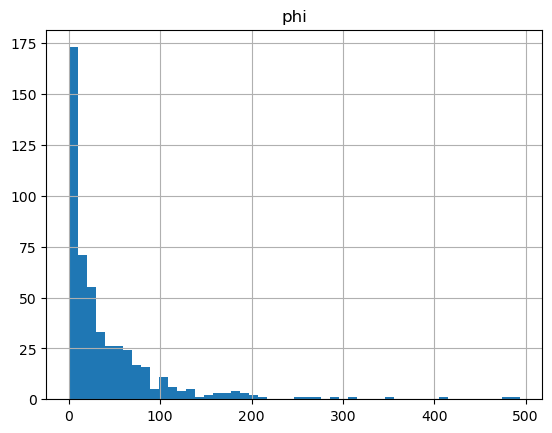

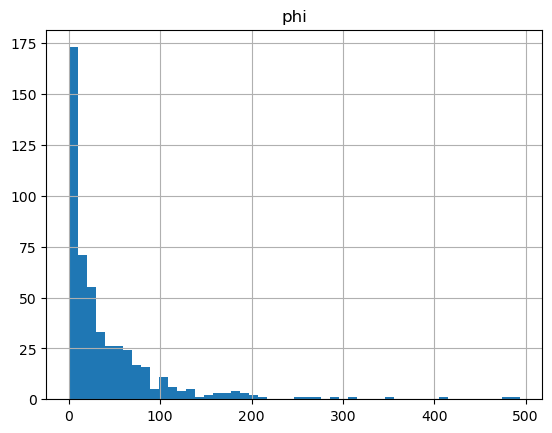

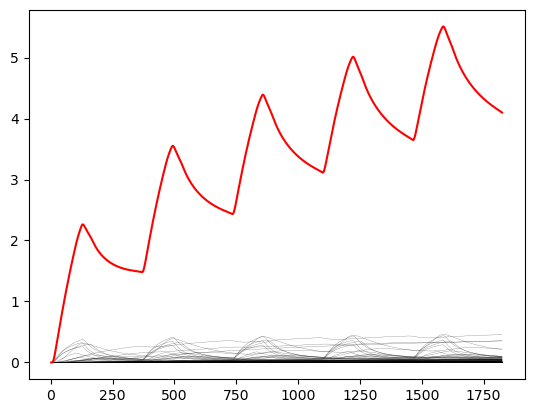

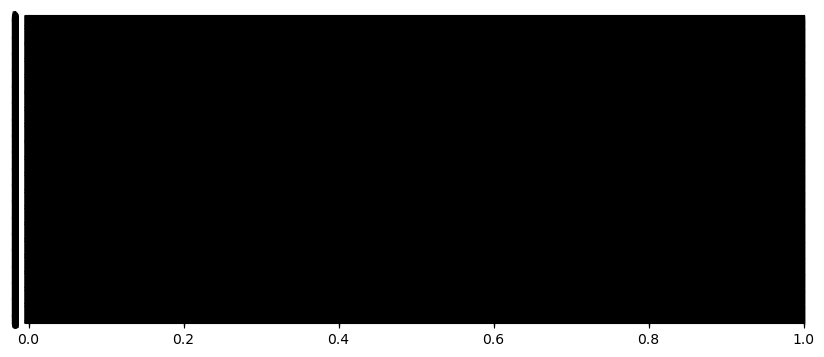

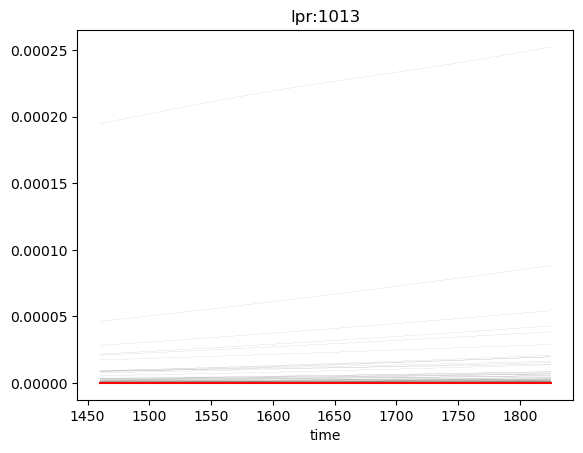

...

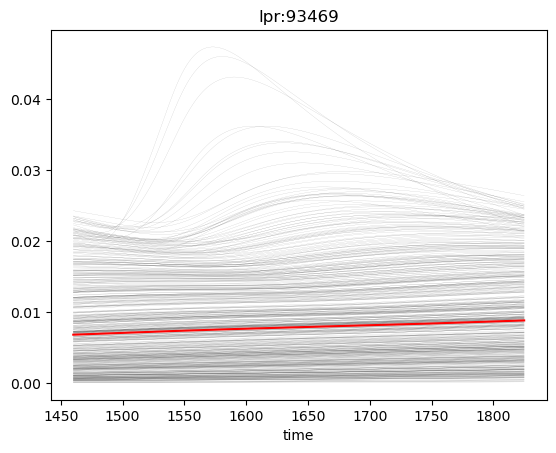

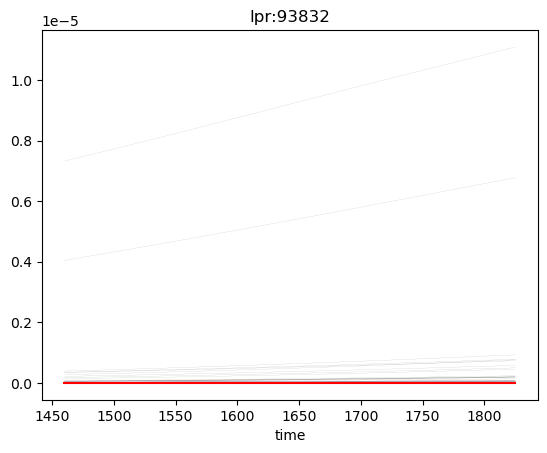

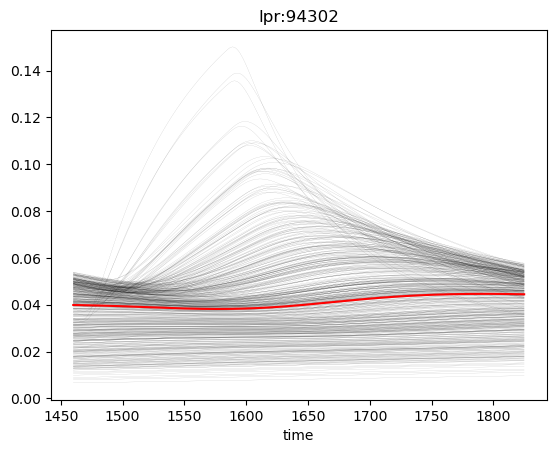

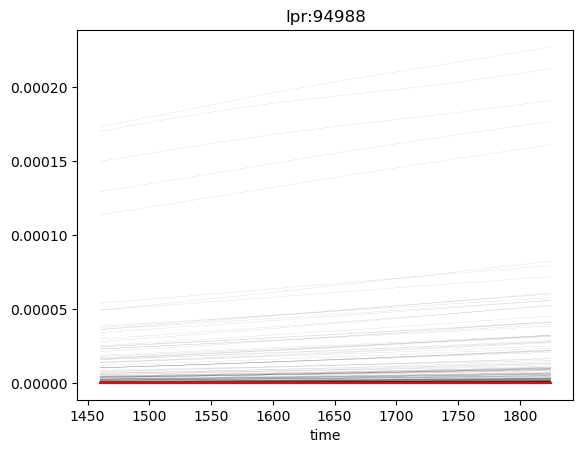

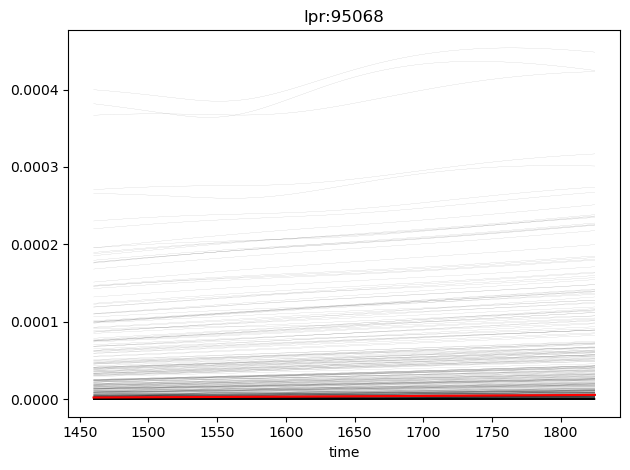

In [53]:
if MonteCarlo == "Y":
    # check phi
    phi = pd.read_csv('./MASTER/prior_mc.phi.actual.csv',index_col=0).T.iloc[5:]
    phi_org = phi.copy()
    phi.columns =['phi']
    phi.hist(bins=50)

    # only change if there are a very small number of extreme outliers
    phitoohigh = 20000000
    phi = phi.loc[phi.phi<phitoohigh]
    phi.hist(bins=50)

    reals_to_keep = phi.index
    reject_reals = list(set(phi_org.index) - set(reals_to_keep)) # Keep rejected realizations in case we want to review them
    print('Number of MC runs kept is ', len(reals_to_keep))

    # read in all MC observations
    # Note: Large file, takes a while to read in. 
    obs = pd.read_csv('./MASTER/prior_mc.0.obs.csv', index_col=0)
    obs.index = obs.index.astype(str)

    obs = obs.loc[reals_to_keep] 

    # parse into time-series
    ts_obs = obs[[i for i in obs.columns if not i.endswith(':bdpl')]]
    bdpl_obs = obs[[i for i in obs.columns if i.endswith(':bdpl')]]

    ts_lox = np.unique([i.split('__')[0] for i in ts_obs.columns])
    
    tmp2 = ts_obs.T.copy()
    tmp2['time'] = [int(i.split('__')[1]) for i in tmp2.index]
    tmp2['lox'] = [str(i.split('__')[0]) for i in tmp2.index]

    # look at timeseries outputs
    all_time_series = pd.read_csv('output/{}.table_report.all_ts.csv'.format(pycap_run_name), index_col=0)
    
    # sum up cumulative depletions (NOTE: assumes only one stream used in MC)
    cum_depl = all_time_series.sum(axis=1)

    # plot up time-series depletions
    fig,ax = plt.subplots(nrows=1, ncols=1)
    ax.plot(all_time_series, alpha=0.6, c='k', lw=0.2)
    ax.plot(cum_depl, c='r')
    #fig.set_title('Cumulative Depl in all streams in Monte Carlo Analysis')
    plt.savefig('output/cum_depl_MC_{}.png'.format(pycap_run_name))

    # plot up each well's last year of depletion
    fig,ax = plt.subplots(nrows=len(ts_lox), ncols=1, sharex=True, figsize=(10,4))
    i=0
                
    for cts in ts_lox:
        tmp = tmp2.loc[tmp2['lox']==cts]
        tmp.set_index('time', drop = True, inplace=True)
        tmp = tmp.drop('lox', axis=1)
        ax =tmp.plot(alpha=0.4, c='k', lw=0.1, legend=None)
        tmp['base'].plot(c='r')
        ax.set_title(cts)
        i+=1
    plt.tight_layout()
    plt.savefig('output/individual_depl_MC_{}.png'.format(pycap_run_name))
